### Phases of each signal
RMS,
Amplitudes,
Evolution rate related features (envelopes, derivatives)

In [1]:
import numpy as np

# Load data
data = np.load('/home/vincent/MySSD/JupyterProjects/AAA_projects/UnlimitedResearchCooperative/Synthetic_Intelligence_Labs/Bio-Silicon-Synergetic-Intelligence-System/Software/PC/Backend/desktop_browser_app/signals_monitor/CNN_feature_extraction_project/all_channels_data.npz')
signals = data['data'][:, :100]  # Use only the first n samples for each channel
names = data['names']  # channel names

/tmp/ipykernel_30156/1141903166.py:50: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  scatter.set_data(angle, radius)
/tmp/ipykernel_30156/1141903166.py:50: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  scatter.set_data(angle, radius)


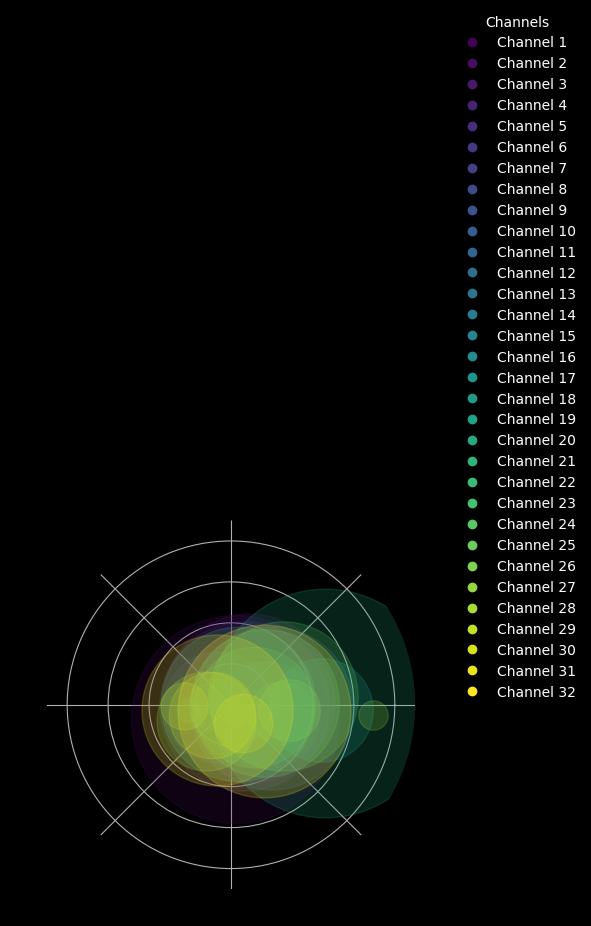

In [4]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['animation.embed_limit'] = 30
from matplotlib.animation import FuncAnimation
from scipy.signal import hilbert
from IPython.display import HTML

# Assuming 'signals' is your dataset and has been preloaded
N = signals.shape[0]  # Number of channels
T = signals.shape[1]  # Number of time points

# Compute the analytical signal to get phases and amplitudes
analytic_signals = hilbert(signals, axis=1)
phases = np.angle(analytic_signals)
amplitudes = np.abs(analytic_signals)

# Calculate RMS along the time axis
RMS = np.sqrt(np.mean(np.square(signals), axis=1))

# Compute envelopes and derivatives as additional features
envelopes = np.abs(hilbert(signals, axis=1))  # Simplified envelope computation
derivatives = np.gradient(signals, axis=1)  # Time derivative of the signal

# Initialize figure for animation
fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
fig.patch.set_facecolor('black')
ax.set_facecolor('black')

# Create a colormap that is distinct for each channel
colors = plt.cm.viridis(np.linspace(0, 1, N))

scatters = [ax.plot([], [], 'o', label=f'Channel {i+1}', color=colors[i])[0] for i in range(N)]

# Set up the plot limits and labels
ax.set_ylim(0, np.max(amplitudes) * 1.1)

# Add a legend
legend = ax.legend(loc=(1.1, 0.5), frameon=True, facecolor='none', edgecolor='none', title="Channels")
legend.get_title().set_color("white")
for text in legend.get_texts():
    text.set_color("white")

def update(frame):
    for i, scatter in enumerate(scatters):
        # Position determined by phase and amplitude
        radius = amplitudes[i, frame]
        angle = phases[i, frame]
        scatter.set_data(angle, radius)

        # Adjust marker size by derivative magnitude at this frame
        marker_size = np.abs(derivatives[i, frame]) * 10
        scatter.set_markersize(marker_size)
        
        # Set transparency (alpha) of the circles
        scatter.set_alpha(0.2)
    
    return scatters


# Create animation
ani = FuncAnimation(fig, update, frames=20, blit=True, repeat=False)

# Display the animation
HTML(ani.to_jshtml())

### Spectral Analysis Visualization

Frequencies,
PSDs, 
Delta, theta, alpha, beta band powers, 
magnitudes


In [1]:
import numpy as np

# Load data
data = np.load('/home/vincent/MySSD/JupyterProjects/AAA_projects/UnlimitedResearchCooperative/Synthetic_Intelligence_Labs/Bio-Silicon-Synergetic-Intelligence-System/Software/PC/Backend/desktop_browser_app/signals_monitor/CNN_feature_extraction_project/all_channels_data.npz')
signals = data['data'][:, :1000]  # Use only the first n samples for each channel
names = data['names']  # channel names

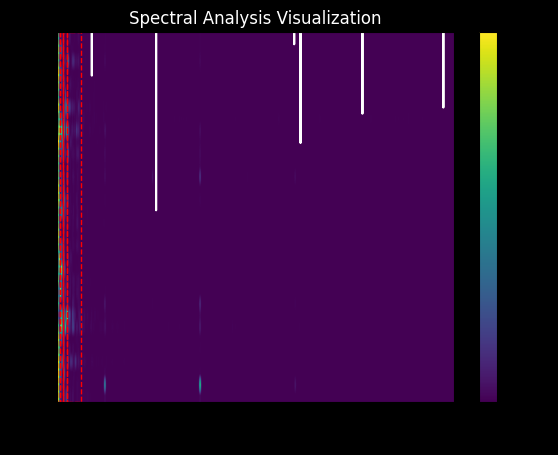

In [3]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['animation.embed_limit'] = 30
from matplotlib.animation import FuncAnimation
from scipy.signal import welch
from IPython.display import HTML
from scipy.fftpack import fft, fftfreq
import matplotlib.patches as patches  

fs = 1000  # Sampling frequency

# Assuming 'signals' is your dataset and has been preloaded
N = signals.shape[0]  # Number of channels
T = signals.shape[1]  # Number of time points

def spectral_centroids(signals, fs):
    # Calculate the spectral centroids for each signal and return magnitudes for visualization
    centroids = []
    all_magnitudes = []
    for signal in signals:
        fft_result = fft(signal)
        frequencies = fftfreq(len(signal), 1.0 / fs)
        magnitude = np.abs(fft_result)
        centroid = np.sum(frequencies * magnitude) / np.sum(magnitude)
        centroids.append(centroid)
        all_magnitudes.append(magnitude)
    return centroids, all_magnitudes

# Precompute the frequency bins and PSDs for each channel
frequencies, psds = welch(signals, fs=fs, nperseg=T, axis=1)
psds /= np.max(psds, axis=1, keepdims=True)  # Normalize PSDs for better visualization

# Calculate initial magnitudes for visualization
_, initial_magnitudes = spectral_centroids(signals, fs)

# Initialize figure for animation
fig, ax = plt.subplots()
fig.patch.set_facecolor('black')
ax.set_facecolor('black')
ax.set_xlabel('Frequency (Hz)')
ax.set_ylabel('Power Spectral Density (Normalized)')
plt.title('Spectral Analysis Visualization', color='white')

# Set up the PSD heatmap
psd_image = ax.imshow(psds, aspect='auto', origin='lower', extent=[frequencies[0], frequencies[-1], 0, N], cmap='viridis')
colorbar = fig.colorbar(psd_image, ax=ax)
colorbar.set_label('Normalized Power')

# Set up a line plot for magnitudes
line, = ax.plot([], [], color='white')  # Empty line plot

# Define frequency bands
bands = {
    'Delta': (0.5, 4),
    'Theta': (4, 8),
    'Alpha': (8, 13),
    'Beta': (13, 30)
}

# Function to create rectangles for each band
def create_rectangles(ax, bands):
    rectangles = []
    for band, (low_freq, high_freq) in bands.items():
        rect = patches.Rectangle((low_freq, 0), high_freq-low_freq, N, linewidth=1, edgecolor='r', facecolor='none', linestyle='--')
        ax.add_patch(rect)
        rectangles.append(rect)
    return rectangles

# Overlay rectangles for each band
rectangles = create_rectangles(ax, bands)

# Update rectangles for each band
def update_rectangles(bands):
    for rect, (_, (low_freq, high_freq)) in zip(rectangles, bands.items()):
        rect.set_x(low_freq)
        rect.set_width(high_freq - low_freq)

def update(frame):
    # Simulate new signal data and update visualizations
    new_signals = signals * np.random.uniform(0.9, 1.1, signals.shape)
    _, new_magnitudes = spectral_centroids(new_signals, fs)
    
    # Update the PSD image
    new_frequencies, new_psds = welch(new_signals, fs=fs, nperseg=T, axis=1)
    new_psds /= np.max(new_psds, axis=1, keepdims=True)
    psd_image.set_data(new_psds)
    
    # Update the magnitude line plot
    line.set_data(frequencies[:len(new_magnitudes[0])//2], new_magnitudes[0][:len(new_magnitudes[0])//2])
    
    # Update rectangles for each band
    update_rectangles(bands)
    
    # Adjust x-axis limits
    ax.set_xlim(0, fs / 2)  # Set x-axis limits to the frequency range from 0 to Nyquist frequency

    return [psd_image, line] + rectangles


# Create animation
ani = FuncAnimation(fig, update, frames=20, blit=True, repeat=False)

# Display the animation
HTML(ani.to_jshtml())



### Phase Synchronization and Interaction Visualization

Phase locking values, 
Pairwise phase locking values, 
Spectral centroids

In [1]:
import numpy as np

# Load data
data = np.load('/home/vincent/MySSD/JupyterProjects/AAA_projects/UnlimitedResearchCooperative/Synthetic_Intelligence_Labs/Bio-Silicon-Synergetic-Intelligence-System/Software/PC/Backend/desktop_browser_app/signals_monitor/CNN_feature_extraction_project/all_channels_data.npz')
signals = data['data'][:, :100]  # Use only the first n samples for each channel
names = data['names']  # channel names|

In [2]:
%matplotlib inline
import matplotlib as mpl
mpl.rcParams['animation.embed_limit'] = 30
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from scipy.signal import hilbert, spectrogram
from scipy.stats import zscore

# Assuming 'signals' is your dataset and has been preloaded
N = signals.shape[0]  # Number of channels
T = signals.shape[1]  # Number of time points

# Compute the analytical signal and extract the phase for each channel
analytic_signals = hilbert(signals, axis=1)
phases = np.angle(analytic_signals)

# Compute Phase Locking Values (PLV)
plv = np.abs(np.mean(np.exp(1j * phases), axis=0))

# Compute Pairwise Phase Locking Values (PPV)
ppv = np.zeros((N, N))
for i in range(N):
    for j in range(i + 1, N):
        ppv[i, j] = np.abs(np.mean(np.exp(1j * (phases[i] - phases[j]))))
        ppv[j, i] = ppv[i, j]
ppv_flat = ppv[np.triu_indices(N, 1)]  # Flatten the upper triangle of the matrix

# Compute Spectral Centroids for each time frame matching the PLV computation
spectral_centroids = []
for signal in signals:
    freqs, _, spec = spectrogram(signal, fs=1.0, nperseg=5, noverlap=2)
    sc = np.sum(freqs[:, None] * spec, axis=0) / np.sum(spec, axis=0)  # Corrected broadcasting
    if len(sc) < len(plv):
        sc = np.interp(np.linspace(0, 1, num=len(plv)), np.linspace(0, 1, num=len(sc)), sc)
    spectral_centroids.append(sc)
sc = np.mean(spectral_centroids, axis=0)

# Normalize features
plv_norm = zscore(plv)
ppv_norm = zscore(ppv_flat)
sc_norm = zscore(sc)

# Create 2D plot with black background
fig, ax = plt.subplots(figsize=(10, 6))
ax.set_facecolor('black')

# Time vector (assuming even spacing)
time = np.linspace(0, 1, num=len(plv_norm))

# Plot with varying color, thickness, and style
for i in range(len(time) - 1):
    color = plt.cm.plasma(plv_norm[i])  # Color map for PLV
    linewidth = 2 + 4 * (ppv_norm[i] + 1) / (np.max(ppv_norm) + 1)  # Scale linewidth by normalized PPV
    linestyle = '-' if sc_norm[i] >= 0 else '--'  # Line style based on Spectral Centroids
    ax.plot(time[i:i+2], plv_norm[i:i+2], color=color, linewidth=linewidth, linestyle=linestyle)

ax.set_xlabel('Time')
ax.set_ylabel('Normalized PLV')
ax.set_title('Dynamic Visualization of Signal Features Over Time')

plt.show()

ValueError: All values in the dash list must be non-negative

<Figure size 1000x600 with 1 Axes>

### Statistical and Variability Visualization

Variance, 
Standard deviations, 
Spectral entropies

In [1]:
import numpy as np

# Load data
data = np.load('/home/vincent/MySSD/JupyterProjects/AAA_projects/UnlimitedResearchCooperative/Synthetic_Intelligence_Labs/Bio-Silicon-Synergetic-Intelligence-System/Software/PC/Backend/desktop_browser_app/signals_monitor/CNN_feature_extraction_project/all_channels_data.npz')
signals = data['data'][:, :10]  # Use only the first n samples for each channel
names = data['names']  # channel names

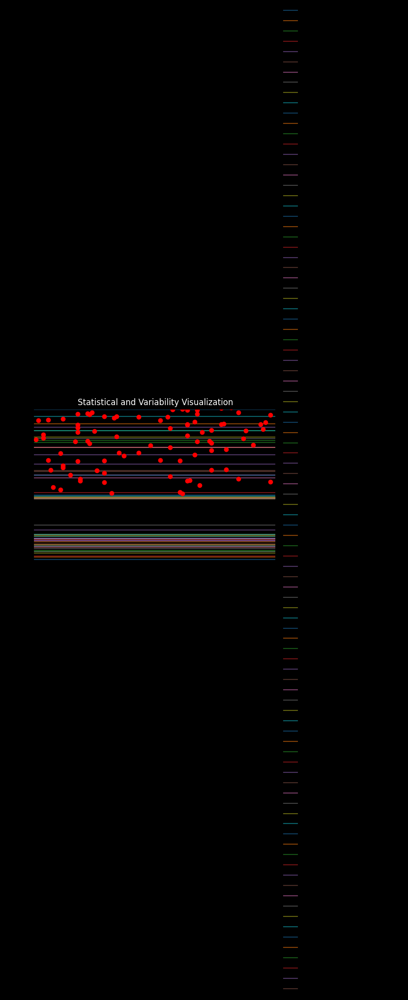

In [6]:

%matplotlib inline
import numpy as np
import matplotlib as mpl
mpl.rcParams['animation.embed_limit'] = 30
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from scipy.signal import find_peaks
from IPython.display import HTML

# Assuming 'signals' is your dataset and has been preloaded
N = signals.shape[0]  # Number of channels
T = signals.shape[1]  # Number of time points

# Compute statistical metrics for all channels
variance = np.var(signals, axis=1)
std_dev = np.std(signals, axis=1)
spectral_entropy = -np.sum(np.log(signals**2), axis=1)

# Simulated peak detection
peaks = {i: find_peaks(signals[i], height=1)[0] for i in range(N)}

# Initialize figure for animation
fig, ax = plt.subplots()
fig.patch.set_facecolor('black')
ax.set_facecolor('black')
ax.set_xlabel('Time')
ax.set_ylabel('Metrics')
plt.title('Statistical and Variability Visualization', color='white')

# Set axes limits
ax.set_xlim(0, T)
ax.set_ylim(-50, 50)  # Adjust based on expected range of your data

# Create lines and markers for each channel
lines_variance = [ax.plot([], [], label=f'Channel {i} Variance', alpha=0.5)[0] for i in range(N)]
lines_std_dev = [ax.plot([], [], label=f'Channel {i} Std Dev', alpha=0.5)[0] for i in range(N)]
lines_spectral_entropy = [ax.plot([], [], label=f'Channel {i} Spectral Entropy', alpha=0.5)[0] for i in range(N)]
peak_markers = [ax.plot([], [], 'o', color='red')[0] for i in range(N)]

def init():
    for line in lines_variance + lines_std_dev + lines_spectral_entropy + peak_markers:
        line.set_data([], [])
    return lines_variance + lines_std_dev + lines_spectral_entropy + peak_markers

def update(frame):
    x_values = np.arange(frame + 1)
    for i in range(N):
        lines_variance[i].set_data(x_values, np.full(frame + 1, variance[i]) * (1 + np.sin(0.05 * frame)))
        lines_std_dev[i].set_data(x_values, np.full(frame + 1, std_dev[i]) * (1 + np.sin(0.05 * frame)))
        lines_spectral_entropy[i].set_data(x_values, np.full(frame + 1, spectral_entropy[i]) * (1 + np.sin(0.05 * frame)))
        peak_indices = peaks[i][peaks[i] <= frame]
        if peak_indices.size > 0:
            peak_markers[i].set_data(peak_indices, signals[i, peak_indices])
    return lines_variance + lines_std_dev + lines_spectral_entropy + peak_markers

ani = FuncAnimation(fig, update, frames=5, init_func=init, blit=True, repeat=False)

# Display the animation
HTML(ani.to_jshtml())

# Create legend with transparent background to the far right of the plot
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5), facecolor='none', edgecolor='none')
plt.show()

### Peak and Event-Related Features Visualization

Peak counts, 
Average peak heights, 
Average distances between peaks, 
Average prominences

In [1]:
import numpy as np

# Load data
data = np.load('/home/vincent/MySSD/JupyterProjects/AAA_projects/UnlimitedResearchCooperative/Synthetic_Intelligence_Labs/Bio-Silicon-Synergetic-Intelligence-System/Software/PC/Backend/desktop_browser_app/signals_monitor/CNN_feature_extraction_project/all_channels_data.npz')
signals = data['data'][:, :100]  # Use only the first n samples for each channel
names = data['names']  # channel names

Animation size has reached 21036030 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


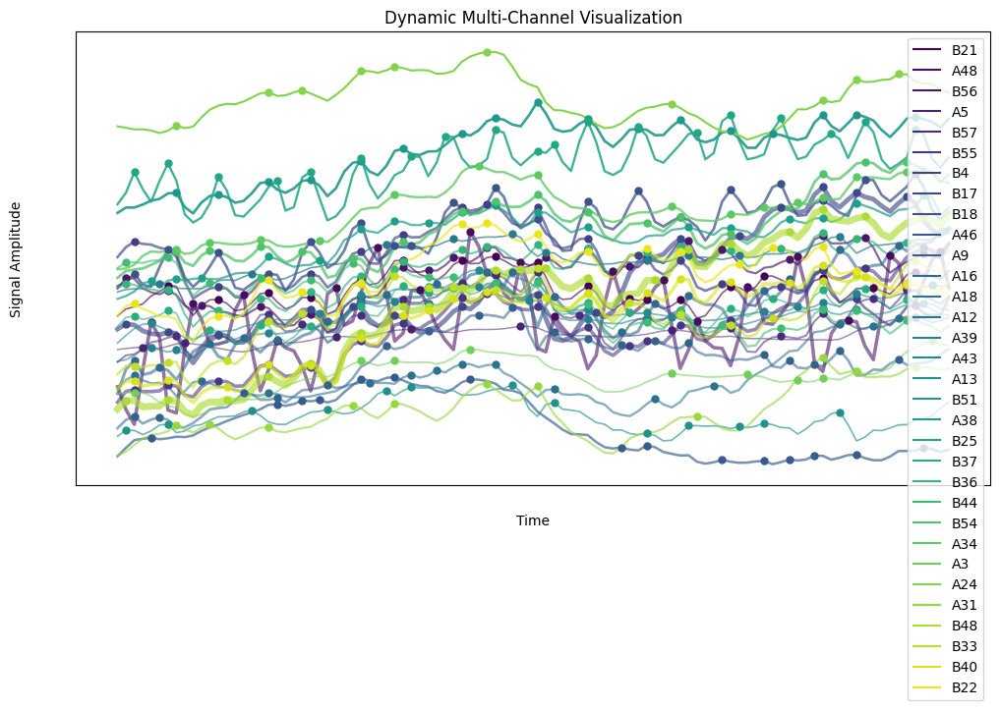

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from scipy.signal import find_peaks
from IPython.display import HTML



N = signals.shape[0]  # Number of channels
T = signals.shape[1]  # Number of time points

fig, ax = plt.subplots(figsize=(12, 6))
colors = [plt.get_cmap('viridis')(int(i / N * 256)) for i in range(N)]
lines = [ax.plot(signals[i, :], label=names[i], color=colors[i])[0] for i in range(N)]
peak_markers = [ax.plot([], [], 'o', markersize=5, color=colors[i])[0] for i in range(N)]

ax.legend(loc='upper right')
ax.set_xlabel("Time")
ax.set_ylabel("Signal Amplitude")
ax.set_title("Dynamic Multi-Channel Visualization")
ax.tick_params(colors='white', which='both')

def update(frame):
    max_var = 0  # To normalize variance
    max_intensity = 0  # To normalize intensity

    # Calculate max values for normalization
    for i in range(N):
        segment_variance = np.var(signals[i])
        max_var = max(max_var, segment_variance)
        color_intensity = np.mean(np.abs(signals[i]))
        max_intensity = max(max_intensity, color_intensity)

    for i in range(N):
        # Dynamically detect and update peaks
        peaks, _ = find_peaks(signals[i], height=None, prominence=1)
        peak_markers[i].set_data(peaks, signals[i][peaks])

        # Update line data directly
        lines[i].set_ydata(signals[i])

        # Update line width based on the normalized variance
        segment_variance = np.var(signals[i])
        lines[i].set_linewidth(1 + 4 * (segment_variance / max_var))

        # Update color intensity based on normalized amplitude
        color_intensity = np.mean(np.abs(signals[i]))
        lines[i].set_alpha(0.5 + 0.5 * (color_intensity / max_intensity))

    return lines + peak_markers

ani = FuncAnimation(fig, update, frames=np.arange(100), blit=True, repeat=True)
HTML(ani.to_jshtml())


### Structural and Fractal Analysis Visualization

Zero crossing rates
Higuchi fractal dimension values
Spectral edge densities
Positive frequencies
Positive FFT results
Cumulative sums
Total powers from the spectral edge density feature group



### Dynamic Changes and Nonlinear Dynamics Visualization
Empirical Mode Decomposition (EMD) IMFs
Time warping factors
Evolution rates (envelopes, derivatives)
Signal shapes
Average signal shapes

### other

In [ ]:
import numpy as np

# Load data
data = np.load('/home/vincent/MySSD/JupyterProjects/AAA_projects/UnlimitedResearchCooperative/Synthetic_Intelligence_Labs/Bio-Silicon-Synergetic-Intelligence-System/Software/PC/Backend/desktop_browser_app/signals_monitor/CNN_feature_extraction_project/all_channels_data.npz')
signals = data['data'][:, :10]  # Use only the first n samples for each channel
names = data['names']  # channel names

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def plot_signals_on_circle(signals, radii_increment, sampling_rate):
    num_signals = signals.shape[0]
    duration = signals.shape[1] / sampling_rate
    theta = np.linspace(0, -2 * np.pi, signals.shape[1])  # Change theta direction to clockwise

    fig, ax = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(8, 8))

    # Hide the radial grid lines
    ax.yaxis.grid(False)

    # Set the axis background color to transparent
    ax.patch.set_visible(False)
    
    # Hide the axis line
    ax.spines['polar'].set_visible(False)

    # Set the thetagrids to match 0.25 second increments
    ax.set_thetagrids(np.arange(0, 360, 90), labels=[f'{duration - x * duration / 4:.2f}s' for x in range(4)])  # Adjust labels for clockwise direction

    for i in range(num_signals):
        radius = (i + 1) * radii_increment + signals[i]
        ax.plot(theta, radius, linewidth=1, color='red')  # Make all signal lines red

    plt.show()

# Example usage:
num_signals = 8  # Number of signals
sampling_rate = 1000  # Sampling rate in Hz
signal_length = 1000  # Number of samples
radii_increment = 1  # Distance between each signal

# Generate some example signals, replace this with your actual signals
signals = np.random.rand(num_signals, signal_length)

plot_signals_on_circle(signals, radii_increment, sampling_rate)

# Main execution
if __name__ == "__main__":